# Project 4, Partial Differential Equations
**Devon DeJohn** | PHY 4611 | March 30, 2019

> This project explores the "marching method" for solving the heat/diffusion equation in a 1D rod.

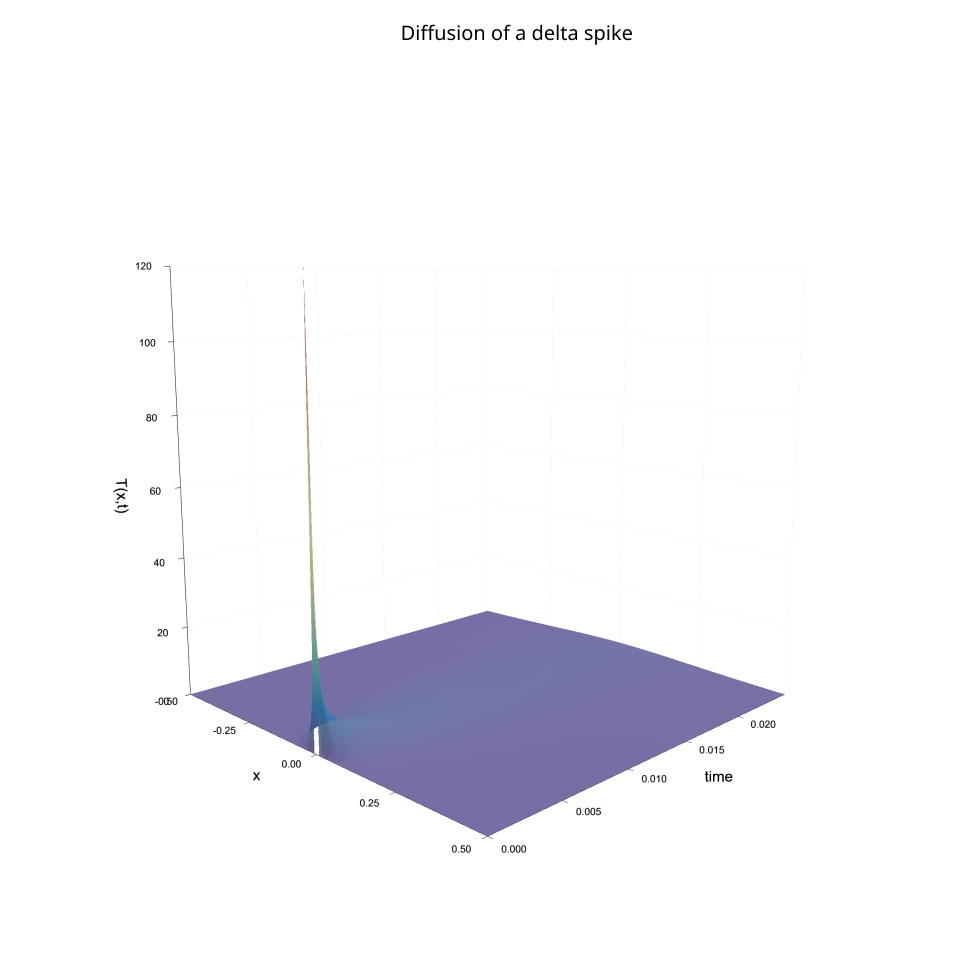

In [28]:
dat = heat_eq(1e-5,121, mthd=dftcs)
plot_temps(dat)

In [14]:
plot_contour(dat)

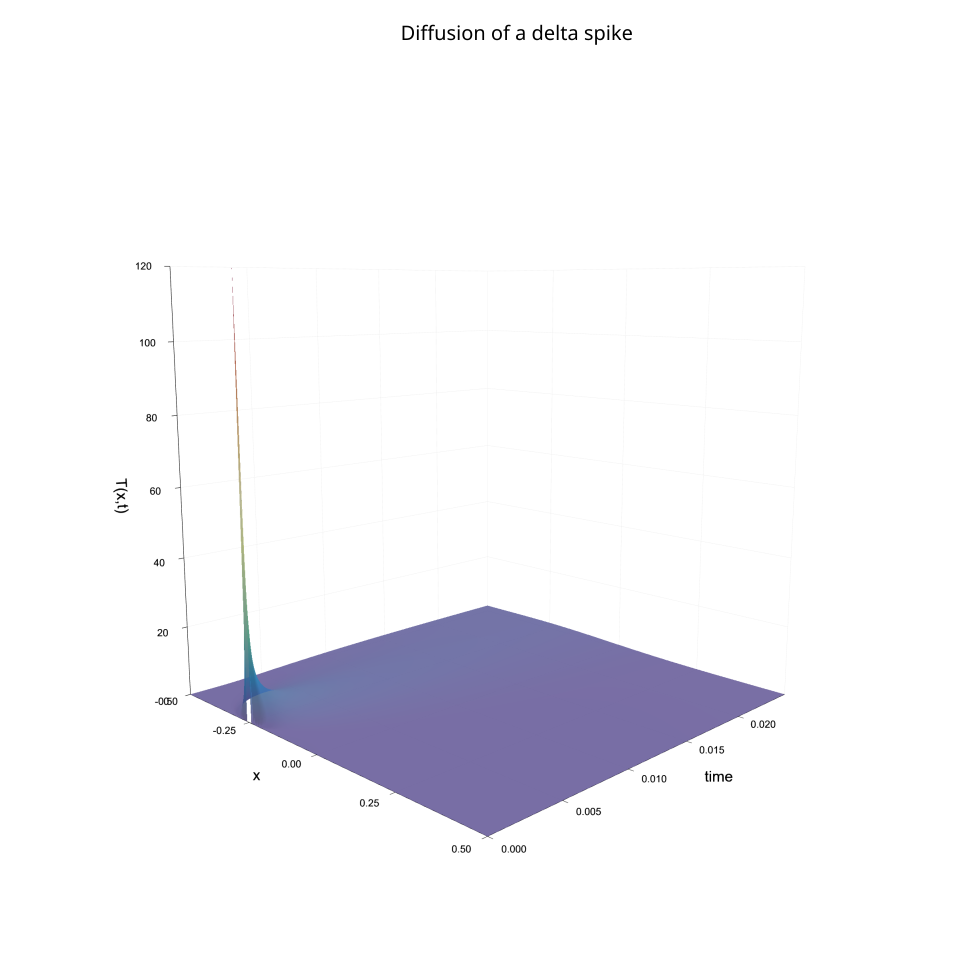

In [25]:
dat = heat_eq(1e-5, 121, mthd=nftcs, offset=1/4)
plot_temps(dat)

In [16]:
plot_contour(dat)

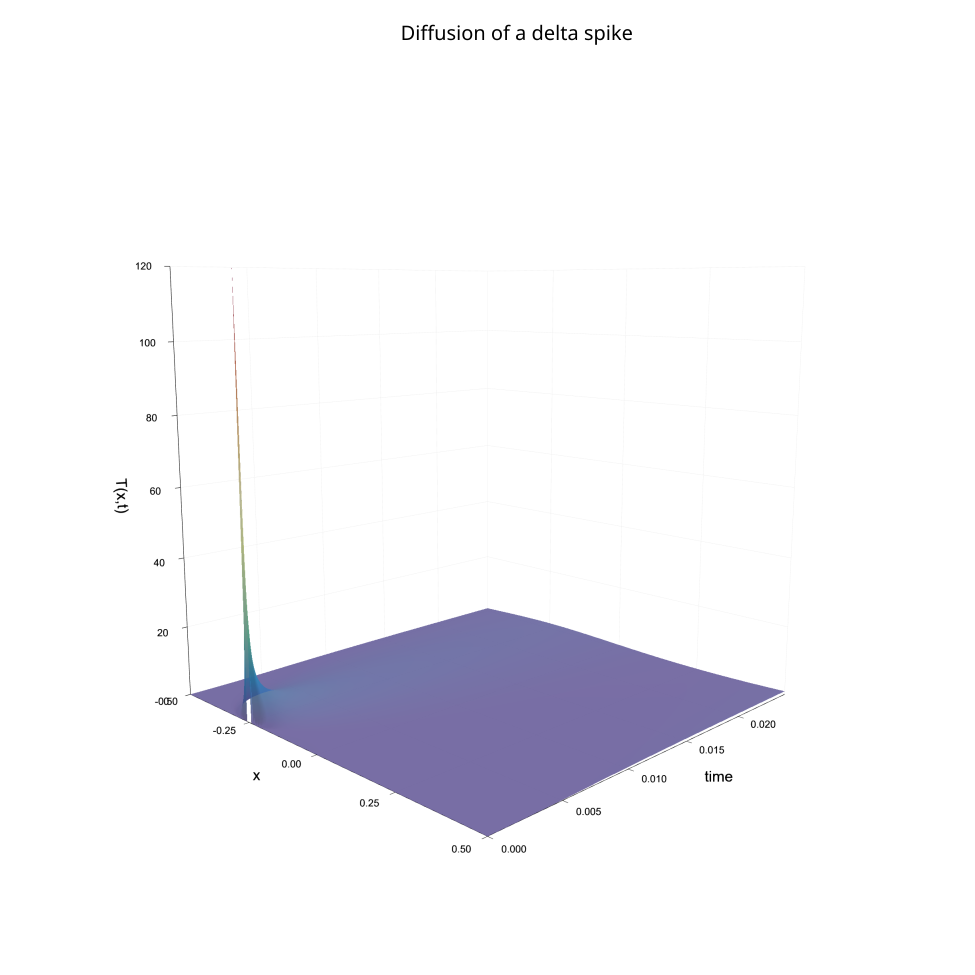

In [26]:
dat = heat_eq(1e-5, 121, mthd=pftcs, offset=1/4)
plot_temps(dat)

In [18]:
plot_contour(dat)

![temp](https://i.imgur.com/2Y5eh3S.gif)
![sine](https://i.imgur.com/WP574At.gif)

In [22]:
using Plots
using Random

# Length of rod and diffusivity constants.
const L = 1.
const diff = 1.

# Dirichlet Forward Time Centered Space (ends fixed at 0°C).
function dftcs(temps, k)
    steps = size(temps,1)
    n = size(temps,2)

    for i in 2:steps
        for j in 2:(n-1)
            temps[i,j] = temps[i-1,j] + k*(temps[i-1,j-1] + temps[i-1,j+1] - 2*temps[i-1,j])
        end
    end
    return temps
end

# Neumann Forward Time Centered Space (zero flux at ends).
function nftcs(temps, k)
    steps = size(temps,1)
    n = size(temps,2)
    
    for i in 2:steps
        for j in 2:(n-1)
            temps[i,j] = temps[i-1,j] + k*(temps[i-1,j-1] + temps[i-1,j+1] - 2*temps[i-1,j])
        end
        temps[i,1] = temps[i,2]
        temps[i,n] = temps[i,n-1]
    end
    return temps
end

# Periodic Forward Time Centered Space (flux equal at both ends).
function pftcs(temps, k)
    steps = size(temps,1)
    n = size(temps,2)
    
    for i in 2:steps
        temps[i,1] = temps[i-1,1] + k*(temps[i-1,n] + temps[i-1,2] - 2*temps[i-1,1])
        
        for j in 2:(n-1)
            temps[i,j] = temps[i-1,j] + k*(temps[i-1,j-1] + temps[i-1,j+1] - 2*temps[i-1,j])
        end
        
        temps[i,n] = temps[i-1,n] + k*(temps[i-1,n-1] + temps[i-1,1] - 2*temps[i-1,n])
    end
    return temps
end

# Compute temperature in 1D rod of length L and diffusivity 1
# where t = timestep, n = number of grid points, mthd = dftcs, nftcs, or pftcs
# (dirichlet, neumann, or periodic BC's)
function heat_eq(t, n; mthd, offset=1/2)
    # Grid spacing.
    h = L/(n-1)

    # FTCS coefficient.
    k = diff*t/h^2

    # Initial conditions; integrate to t=0.025 seconds.
    steps = Int(round(0.025/t))
    xi = Int(ceil(offset*n))
    temps = zeros(steps, n)
    temps[1, xi] = 1.0/h

    # x- and time-values for plotting
    xvals = [-L/2 + h*i for i in 0:(n-1)]
    tvals = [t*i for i in 0:(steps-1)]

    return (mthd(temps, k), xvals, tvals)
end

function rand_eq(t, n; mthd)
    # Grid spacing.
    h = L/(n-1)

    # FTCS coefficient.
    k = diff*t/h^2

    # Initial conditions; integrate to t=0.025 seconds.
    steps = Int(round(0.025/t))
    temps = zeros(steps, n)

    # x- and time-values for plotting
    xvals = [-L/2 + h*i for i in 0:(n-1)]
    tvals = [t*i for i in 0:(steps-1)]
    
    for (i,x) in enumerate(xvals)
        temps[1, i] = cos(25*x)*sin(2*x) + 2*exp(-x^2)
    end

    return (mthd(temps, k), xvals, tvals)
end

function plot_temps(dat)
    plotlyjs(fmt=:svg)
    temp, x, t = dat
    surface(x, t, temp, title=:"Diffusion of a delta spike",
            xlabel=:"x", ylabel=:"time", zlabel=:"T(x,t)", 
            alpha=0.9, color=:Spectral_r, colorbar=false,
            st=:surface, size=(975,975), camera=(45,10))
end

function plot_contour(dat)
    gr(fmt=:svg)
    temp, x, t = dat
    contour(x, t, temp, title=:"Temperature contour plot (0.1° increments)",
            xlabel=:"x", ylabel=:"time", 
            levels=[i for i in 0.:0.2:8.],
            color=:Spectral_r, alpha=1.0, colorbar=false,
            st=:contourf, contour_labels=true, size=(900,900))
end

function gifify(dat)
    gr()
    temp, x, t = dat
    max_T = maximum(temp)
    min_T = minimum(temp)
    min_x = minimum(x)
    max_x = maximum(x)

    @gif for i=1:Int(round(size(temp,1)/3))
        time = "t = $(t[i]) s"
        plot(size=(900,450), title=:"Sinusoidal temperature distribution approaching steady state in insulated 1D bar",
                xlabel=:"x", ylabel=:"T(x,t)", xlims=(min_x, max_x), ylims=(min_T,max_T))
        plot!(x, temp[i, :], lw=4, label=:time)
    end every 5
end;

In [21]:
# ddat = heat_eq(1e-5, 41, mthd=dftcs, offset=1/8)
# ndat = heat_eq(1e-5, 41, mthd=nftcs, offset=1/8)
# pdat = heat_eq(1e-5, 41, mthd=pftcs, offset=1/8)

# dtemp, dx, dt = ddat
# ntemp, nx, nt = ndat
# ptemp, px, pt = pdat
# max_T = maximum(dtemp)/2
# min_x = minimum(dx)
# max_x = maximum(dx)

# gr()
# @gif for i=1:Int(round(size(dtemp,1)/3))
#     plot(size=(900,450), title=:"Temperature distribution over time from a delta spike at L/8",
#             xlabel=:"x", ylabel=:"T(x,t)", xlims=(min_x, max_x), ylims=(0.,max_T))
#     plot!(dx, dtemp[i, :], lw=4, label=:"Dirichlet")
#     plot!(nx, ntemp[i, :], lw=4, label=:"Neumann")
#     plot!(px, ptemp[i, :], lw=4, label=:"Periodic")
# end every 5